This tutorial processes C. elegans embryogenesis single cell data published by [Packer & Zhu et al., 2019](https://doi.org/10.1126/science.aax1971). Data can be downloaded from https://zenodo.org/records/15236812.

In [1]:
%load_ext autoreload
%autoreload 2

### Load package and data

In [2]:
import concord as ccd
import scanpy as sc
import torch
import warnings
from pathlib import Path
import time
warnings.filterwarnings('ignore')

data_dir = Path('../data/celegans_data/') # Replace with your data directory
data_path = data_dir / "celegans_global_adata.h5ad"
adata = sc.read(data_path)

In [3]:
proj_name = "concord_celegans"
save_dir = f"../save/{proj_name}-{time.strftime('%b%d')}/" # Replace with your save directory if needed
save_dir = Path(save_dir)
save_dir.mkdir(parents=True, exist_ok=True)
device = torch.device('cuda:0' if torch.cuda.is_available() else 'cpu') # Replace with your device, for example, 'mps' for Apple silicon
file_suffix = f"{time.strftime('%b%d-%H%M')}" # Replace with your file suffix if needed
seed = 0

In [4]:
adata.layers["counts"] = adata.X.copy() # Store raw counts in a layer, because adata.X can be modified
adata = adata[adata.obs['to.filter'] == 'FALSE'] # Only keep cells that pass quality filter

### Run Concord

In [5]:
feature_list = ccd.ul.select_features(adata, n_top_features=10000, flavor='seurat_v3') # Loosely select features based on Seurat v3 method (so that enough information is preserved)

concord_args = {
        'adata': adata,
        'input_feature': feature_list,
        'batch_size':64, # Batch size for training, adjust as needed
        'latent_dim': 300, # Latent dimension size, adjust as needed
        'encoder_dims':[1000], # Encoder dimensions, recommended to be larger than latent_dim
        'use_decoder': False, # Whether to use a decoder, set to True if you want to use the decoder
        'decoder_dims':[1000], # Decoder dimensions, ignored if use_decoder is False
        'augmentation_mask_prob': 0.3, # Probability of masking features, recommended to be between 0.2 and 0.5
        'clr_temperature': 0.3, # Temperature for contrastive loss, recommended to be between 0.1 and 0.5
        'p_intra_knn': 0.3, # Probability of intra-neighborhood sampling, must be less than 0.5
        'sampler_knn': 300, # Size of neighbohood for intra-neighborhood sampling
        'p_intra_domain': .95, # Enrichment probability for intra-domain sampling, recommended to be between 0.85 and 1.0, note the lower the value, the more dataset-specific information (may contain batch effects) is preserved
        'n_epochs': 15, # Number of epochs for training, adjust as needed
        'domain_key': 'batch', # Key in adata.obs for batch labels
        'verbose': True, # Verbosity level, set to True for more detailed output
        'seed': seed, # random seed for reproducibility
        'load_data_into_memory': False, # Whether to load data into memory, set to False if memory is a concern
        'device': device, # Device for training, can be 'cpu', 'cuda', or 'mps'
        'save_dir': save_dir # Directory to save the model and results
    }

concord.utils.feature_selector - INFO - Selecting highly variable features with flavor seurat_v3...


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [6]:
output_key = 'Concord'
cur_ccd = ccd.Concord(**concord_args)
cur_ccd.fit_transform(output_key=output_key) # Result saved to ccd.adata.obsm[output_key]

concord - INFO - Operating directly on the provided AnnData object. Object may be modified.


concord - WARNING - Input data in adata.X appears to be raw counts. CONCORD performs best on normalized and log-transformed data. Consider setting normalize_total=True and log1p=True.
concord - INFO - KNN sampling mode is enabled.
concord - INFO - Using NT-Xent loss with beta=1.0. This will apply hard-negative weighting to the contrastive loss.
concord - INFO - HCL (Contrastive learning with hard negative samples) mode is enabled.
concord - INFO - Column 'batch' is already of type: category
concord - INFO - Unused levels dropped for column 'batch'.
concord - INFO - Encoder input dim: 10000
concord - INFO - Model loaded to device: cpu
concord - INFO - Total number of parameters: 10303956
concord - INFO - Starting 2 warm-up epochs with k-NN sampling disabled.
concord.model.dataloader - INFO - Using 4 DataLoader workers.
concord.model.dataloader - INFO - Filtering features with provided list (10000 features)...
concord.model.anndataset - INFO - Initialized lightweight dataset with 89701 s

Epoch 0 Training: 100%|██████████| 1399/1399 [00:34<00:00, 40.20it/s, loss=2.653]

concord - INFO - Epoch   0 | Train Loss: 2.90, MSE: 0.00, CLASS: 0.00, CONTRAST: 2.90, IMPORTANCE: 0.00
concord - INFO - Starting epoch 2/15
concord - INFO - Processing chunk 1/1 for epoch 2
concord - INFO - Number of samples in train_dataloader: 89701



Epoch 1 Training:  74%|███████▍  | 1035/1399 [00:28<00:06, 57.16it/s, loss=2.496]libc++abi: terminating due to uncaught exception of type std::__1::system_error: Broken pipe
libc++abi: terminating due to uncaught exception of type std::__1::system_error: Broken pipe
libc++abi: terminating due to uncaught exception of type std::__1::system_error: Broken pipe
libc++abi: terminating due to uncaught exception of type std::__1::system_error: Broken pipe
Exception ignored in: <function _MultiProcessingDataLoaderIter.__del__ at 0x10df0f920>
Traceback (most recent call last):
  File "/opt/anaconda3/envs/concord/lib/python3.12/site-packages/torch/utils/data/dataloader.py", line 1604, in __del__
    self._shutdown_workers()
  File "/opt/anaconda3/envs/concord/lib/python3.12/site-packages/torch/utils/data/dataloader.py", line 1568, in _shutdown_workers
    w.join(timeout=_utils.MP_STATUS_CHECK_INTERVAL)
  File "/opt/anaconda3/envs/concord/lib/python3.12/multiprocessing/process.py", line 149, in 

KeyboardInterrupt: 

In [8]:
import os
os.cpu_count()

16

### Visualization

We recommend using UMAP to visualize the CONCORD latent space:

concord - INFO - UMAP embedding stored in adata.obsm['Concord_UMAP']


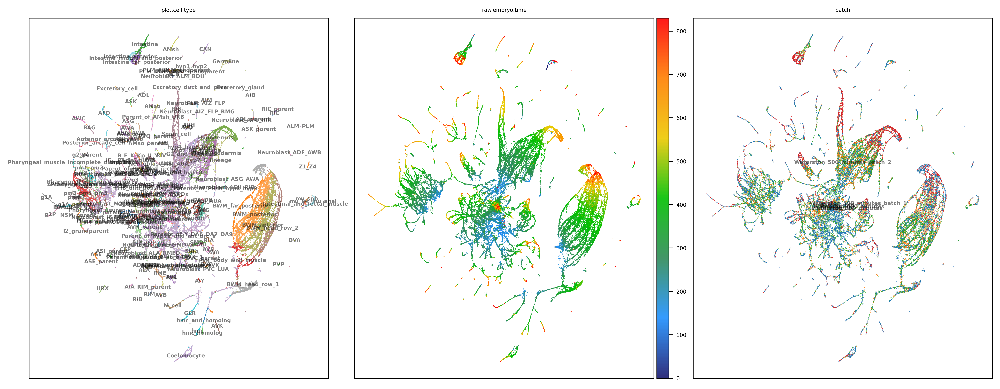

In [7]:
basis = 'Concord'
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP', n_components=2, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
show_basis = basis + '_UMAP'
show_cols = ['plot.cell.type', 'raw.embryo.time', "batch"]
pal = {'plot.cell.type': 'tab20', 'raw.embryo.time': 'BlueGreenRed', "batch": 'tab20'}
ccd.pl.plot_embedding(
    adata, show_basis, show_cols, figsize=(13,5), dpi=600, ncols=3, font_size=5, point_size=2, legend_loc='on data', 
    pal = pal,
    save_path=save_dir / f"{show_basis}_{file_suffix}.png"
)

In [ ]:
ccd.ul.run_umap(adata, source_key=basis, result_key=f'{basis}_UMAP_3D', n_components=3, n_neighbors=30, min_dist=0.1, metric='euclidean', random_state=seed)
import plotly.io as pio
pio.renderers.default = 'notebook'
for col in show_cols:
    show_basis = f'{basis}_UMAP_3D'
    ccd.pl.plot_embedding_3d(
            adata, basis=show_basis, color_by=col,
            pal = pal[col],
            save_path=save_dir / f'{show_basis}_{col}_{file_suffix}.html',
            point_size=1, opacity=0.8, width=1500, height=1000
        )

In [ ]:
adata.write_h5ad(data_dir / f"{proj_name}_{file_suffix}.h5ad") # Save the adata object with the encoded embeddings
print(f"Saved adata to {data_dir / f'{proj_name}_{file_suffix}.h5ad'}")

Saved adata to ../data/celegans_data/concord_celegans_Apr17-1140.h5ad
